In [1]:
%pip install plotly

Note: you may need to restart the kernel to use updated packages.


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px

plt.rcParams["figure.figsize"] = (10,3)

PATH = 'https://github.com/aksenov7/Kaggle_competition_group/blob/master/athlete_events.csv.zip?raw=true'
data = pd.read_csv(PATH, compression='zip', sep=',')
data.head()

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal
0,1,A Dijiang,M,24.0,180.0,80.0,China,CHN,1992 Summer,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,NaN
1,2,A Lamusi,M,23.0,170.0,60.0,China,CHN,2012 Summer,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,NaN
2,3,Gunnar Nielsen Aaby,M,24.0,NaN,NaN,Denmark,DEN,1920 Summer,1920,Summer,Antwerpen,Football,Football Men's Football,NaN
3,4,Edgar Lindenau Aabye,M,34.0,NaN,NaN,Denmark/Sweden,DEN,1900 Summer,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Gold
4,5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988 Winter,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 500 metres,NaN


## 1. Разбор каждой переменной самой по себе.

In [11]:
def analize_column(column):
    dt = column.dtype
    if (dt == np.float64 or dt == np.int64):
        analize_numeric_column(column)
    else:
        analize_categorical_column(column)
        

In [39]:
def analize_categorical_column(column):    
    u = column.nunique()
    print("Unique: ", u)
    
    if u < 10:
        plt.hist(column.dropna(), bins = u)
        plt.show()
  

In [40]:
def analize_numeric_column(column):
    print("Min: ", column.min())
    print("Max: ", column.max())
    print("Mdian: ", column.median())
    print("Average: ", column.mean())
    
    plt.hist(column, bins = 20)
    plt.show()

Name:  Name
Unique:  134732
Name:  Sex
Unique:  2


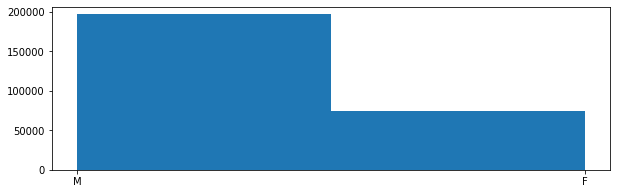

Name:  Age
Min:  10.0
Max:  97.0
Mdian:  24.0
Average:  25.556898357297374


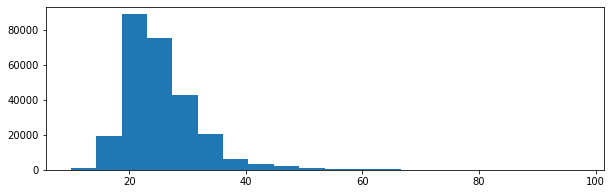

Name:  Height
Min:  127.0
Max:  226.0
Mdian:  175.0
Average:  175.33896987366376


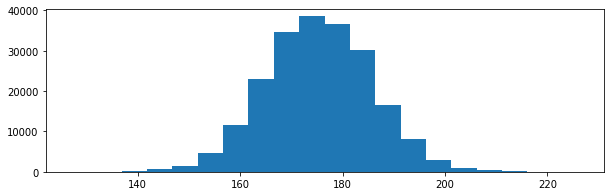

Name:  Weight
Min:  25.0
Max:  214.0
Mdian:  70.0
Average:  70.70239290053351


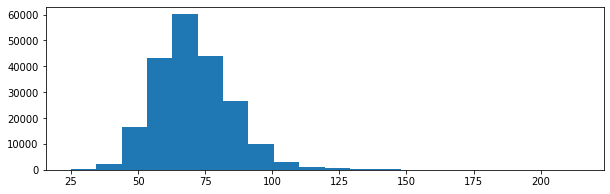

Name:  Team
Unique:  1184
Name:  NOC
Unique:  230
Name:  Games
Unique:  51
Name:  Year
Min:  1896
Max:  2016
Mdian:  1988.0
Average:  1978.3784800601957


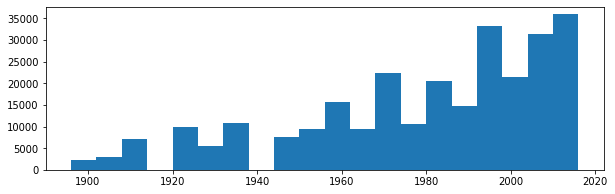

Name:  Season
Unique:  2


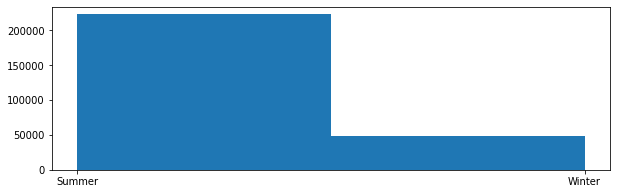

Name:  City
Unique:  42
Name:  Sport
Unique:  66
Name:  Event
Unique:  765
Name:  Medal
Unique:  3


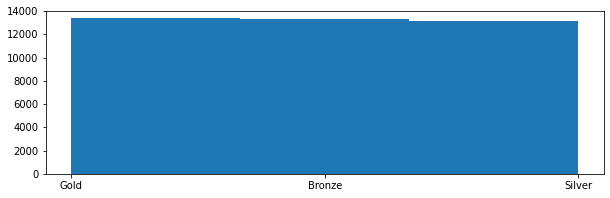

In [41]:
columns = data.columns
for column in columns[1:]:
    print("Name: ", column)
    analize_column(data[column])

## 2. Разбор переменной в разрезе ее группировки по другим признакам, которые являются категориальными.

In [42]:
categories = ["Sex", "NOC", "Season", "City", "Sport", "Medal"]
values = dict()
for category in categories:    
    values[category] = data[category].unique()    

In [43]:
def analize_per_category(column):
    for category in categories:
        if category == column:
            continue
        for value in values[category]:
            filtered = data[data[category] == value][column]
            print(column, " by ", category, ": ", value)
            analize_column(filtered)

Name  by  Sex :  M
Unique:  100979
Name  by  Sex :  F
Unique:  33808
Name  by  NOC :  CHN
Unique:  2494
Name  by  NOC :  DEN
Unique:  1920
Name  by  NOC :  NED
Unique:  2937
Name  by  NOC :  USA
Unique:  9652
Name  by  NOC :  FIN
Unique:  2346
Name  by  NOC :  NOR
Unique:  2214
Name  by  NOC :  ROU
Unique:  1790
Name  by  NOC :  EST
Unique:  354
Name  by  NOC :  FRA
Unique:  6161
Name  by  NOC :  MAR
Unique:  460
Name  by  NOC :  ESP
Unique:  2637
Name  by  NOC :  EGY
Unique:  990
Name  by  NOC :  IRI
Unique:  525
Name  by  NOC :  BUL
Unique:  1474
Name  by  NOC :  ITA
Unique:  4921
Name  by  NOC :  CHA
Unique:  27
Name  by  NOC :  AZE
Unique:  192
Name  by  NOC :  SUD
Unique:  81
Name  by  NOC :  RUS
Unique:  2426
Name  by  NOC :  ARG
Unique:  1848
Name  by  NOC :  CUB
Unique:  1283
Name  by  NOC :  BLR
Unique:  763
Name  by  NOC :  GRE
Unique:  1702
Name  by  NOC :  CMR
Unique:  227
Name  by  NOC :  TUR
Unique:  808
Name  by  NOC :  CHI
Unique:  525
Name  by  NOC :  MEX
Unique:  1544

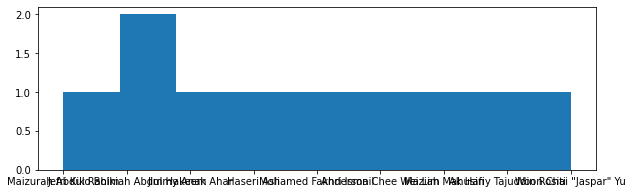

Name  by  NOC :  IND
Unique:  875
Name  by  NOC :  KSA
Unique:  148
Name  by  NOC :  SYR
Unique:  132
Name  by  NOC :  MDV
Unique:  31
Name  by  NOC :  ETH
Unique:  231
Name  by  NOC :  UAE
Unique:  78
Name  by  NOC :  YAR
Unique:  10
Name  by  NOC :  INA
Unique:  275
Name  by  NOC :  PHI
Unique:  389
Name  by  NOC :  SGP
Unique:  172
Name  by  NOC :  UZB
Unique:  295
Name  by  NOC :  KGZ
Unique:  129
Name  by  NOC :  TJK
Unique:  45
Name  by  NOC :  EUN
Unique:  603
Name  by  NOC :  JPN
Unique:  4036
Name  by  NOC :  CGO
Unique:  74
Name  by  NOC :  SUI
Unique:  2868
Name  by  NOC :  BRA
Unique:  2051
Name  by  NOC :  FRG
Unique:  1703
Name  by  NOC :  GDR
Unique:  1356
Name  by  NOC :  MON
Unique:  82
Name  by  NOC :  ISR
Unique:  352
Name  by  NOC :  URU
Unique:  366
Name  by  NOC :  SWE
Unique:  3782
Name  by  NOC :  ISV
Unique:  150
Name  by  NOC :  SRI
Unique:  93
Name  by  NOC :  ARM
Unique:  146
Name  by  NOC :  CIV
Unique:  124
Name  by  NOC :  KEN
Unique:  515
Name  by  NOC :

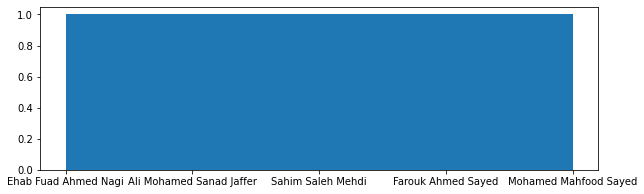

Name  by  NOC :  KOR
Unique:  2289
Name  by  NOC :  THA
Unique:  462
Name  by  NOC :  BER
Unique:  121
Name  by  NOC :  ANZ
Unique:  53
Name  by  NOC :  SCG
Unique:  205
Name  by  NOC :  SLE
Unique:  62
Name  by  NOC :  PNG
Unique:  61
Name  by  NOC :  YEM
Unique:  28
Name  by  NOC :  IOA
Unique:  76
Name  by  NOC :  OMA
Unique:  42
Name  by  NOC :  FIJ
Unique:  128
Name  by  NOC :  VAN
Unique:  25
Name  by  NOC :  MDA
Unique:  131
Name  by  NOC :  YUG
Unique:  1269
Name  by  NOC :  BAH
Unique:  162
Name  by  NOC :  GUA
Unique:  240
Name  by  NOC :  SRB
Unique:  229
Name  by  NOC :  IVB
Unique:  28
Name  by  NOC :  MOZ
Unique:  52
Name  by  NOC :  CAF
Unique:  50
Name  by  NOC :  MAD
Unique:  76
Name  by  NOC :  MAL
Unique:  40
Name  by  NOC :  BIH
Unique:  73
Name  by  NOC :  GUM
Unique:  66
Name  by  NOC :  CAY
Unique:  39
Name  by  NOC :  SVK
Unique:  457
Name  by  NOC :  BAR
Unique:  115
Name  by  NOC :  GBS
Unique:  14
Name  by  NOC :  TLS
Unique:  8


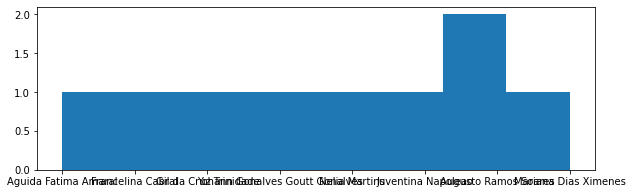

Name  by  NOC :  COD
Unique:  69
Name  by  NOC :  GAB
Unique:  48
Name  by  NOC :  SMR
Unique:  92
Name  by  NOC :  LAO
Unique:  47
Name  by  NOC :  BOT
Unique:  62
Name  by  NOC :  ROT
Unique:  10
Name  by  NOC :  CAM
Unique:  45
Name  by  NOC :  PRK
Unique:  392
Name  by  NOC :  SOL
Unique:  20
Name  by  NOC :  SEN
Unique:  234
Name  by  NOC :  CPV
Unique:  13
Name  by  NOC :  CRT
Unique:  8


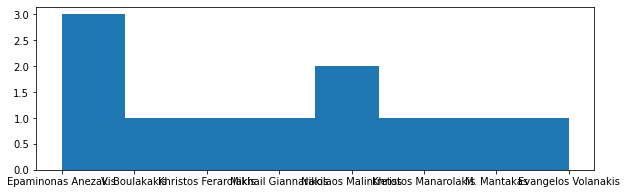

Name  by  NOC :  GEQ
Unique:  26
Name  by  NOC :  BOL
Unique:  89
Name  by  NOC :  SAA
Unique:  36
Name  by  NOC :  AND
Unique:  61
Name  by  NOC :  ANT
Unique:  70
Name  by  NOC :  ZIM
Unique:  196
Name  by  NOC :  GRN
Unique:  44
Name  by  NOC :  HKG
Unique:  321
Name  by  NOC :  LCA
Unique:  21
Name  by  NOC :  FSM
Unique:  18
Name  by  NOC :  MYA
Unique:  85
Name  by  NOC :  MAW
Unique:  59
Name  by  NOC :  ZAM
Unique:  145
Name  by  NOC :  RHO
Unique:  10
Name  by  NOC :  TPE
Unique:  565
Name  by  NOC :  STP
Unique:  13
Name  by  NOC :  MKD
Unique:  47
Name  by  NOC :  BOH
Unique:  66
Name  by  NOC :  TGA
Unique:  38
Name  by  NOC :  LIE
Unique:  131
Name  by  NOC :  MNE
Unique:  55
Name  by  NOC :  GAM
Unique:  33
Name  by  NOC :  COK
Unique:  30
Name  by  NOC :  ALB
Unique:  45
Name  by  NOC :  WIF
Unique:  13
Name  by  NOC :  SWZ
Unique:  42
Name  by  NOC :  BUR
Unique:  32
Name  by  NOC :  NBO
Unique:  2


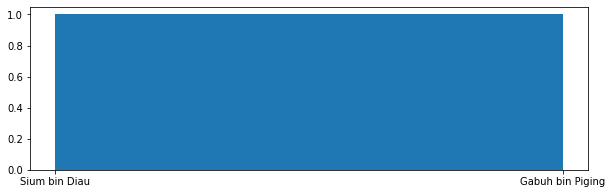

Name  by  NOC :  BDI
Unique:  25
Name  by  NOC :  ARU
Unique:  32
Name  by  NOC :  NRU
Unique:  10
Name  by  NOC :  VNM
Unique:  39
Name  by  NOC :  VIE
Unique:  104
Name  by  NOC :  BHU
Unique:  21
Name  by  NOC :  MHL
Unique:  12
Name  by  NOC :  KIR
Unique:  9


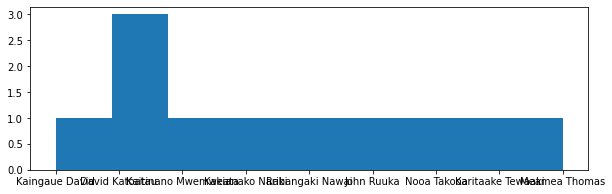

Name  by  NOC :  UNK
Unique:  2


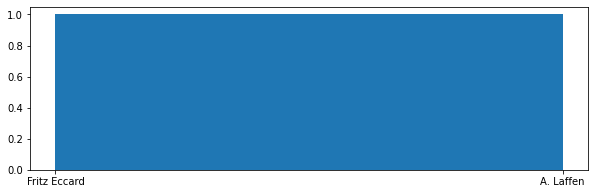

Name  by  NOC :  TUV
Unique:  6


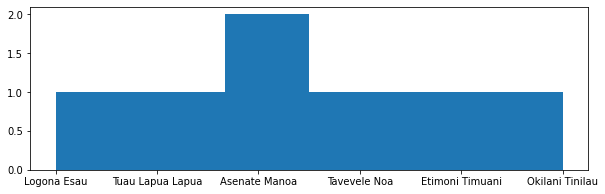

Name  by  NOC :  NFL
Unique:  1


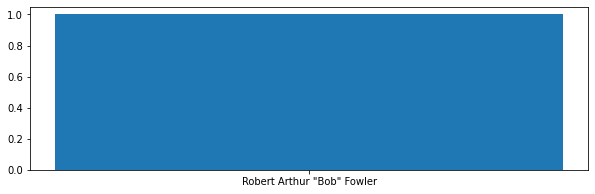

Name  by  NOC :  KOS
Unique:  8


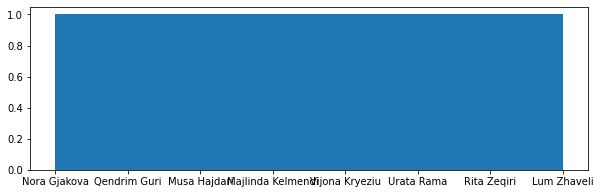

Name  by  NOC :  SSD
Unique:  3


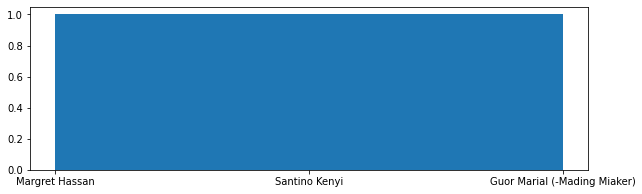

Name  by  NOC :  LES
Unique:  51
Name  by  Season :  Summer
Unique:  116122
Name  by  Season :  Winter
Unique:  18923
Name  by  City :  Barcelona
Unique:  9380
Name  by  City :  London
Unique:  16924
Name  by  City :  Antwerpen
Unique:  2675
Name  by  City :  Paris
Unique:  4468
Name  by  City :  Calgary
Unique:  1425
Name  by  City :  Albertville
Unique:  1801
Name  by  City :  Lillehammer
Unique:  1738
Name  by  City :  Los Angeles
Unique:  8713
Name  by  City :  Salt Lake City
Unique:  2397
Name  by  City :  Helsinki
Unique:  4931
Name  by  City :  Lake Placid
Unique:  1323
Name  by  City :  Sydney
Unique:  10639
Name  by  City :  Atlanta
Unique:  10324
Name  by  City :  Stockholm
Unique:  2567
Name  by  City :  Sochi
Unique:  2744
Name  by  City :  Nagano
Unique:  2178
Name  by  City :  Torino
Unique:  2494
Name  by  City :  Beijing
Unique:  10880
Name  by  City :  Rio de Janeiro
Unique:  11174
Name  by  City :  Athina
Unique:  11536
Name  by  City :  Squaw Valley
Unique:  665
Name

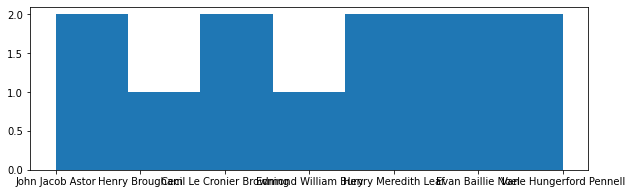

Name  by  Sport :  Motorboating
Unique:  14
Name  by  Sport :  Military Ski Patrol
Unique:  24
Name  by  Sport :  Croquet
Unique:  10
Name  by  Sport :  Jeu De Paume
Unique:  11
Name  by  Sport :  Roque
Unique:  4


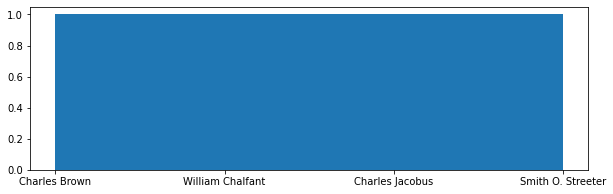

Name  by  Sport :  Alpinism
Unique:  25
Name  by  Sport :  Basque Pelota
Unique:  2


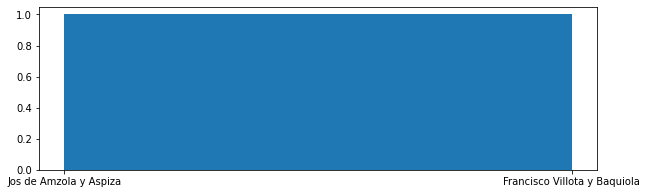

Name  by  Sport :  Aeronautics
Unique:  1


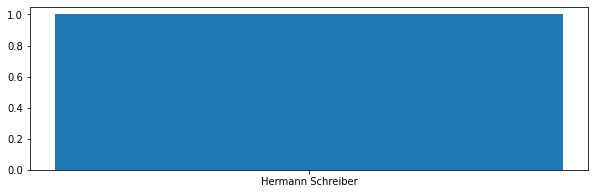

Name  by  Medal :  nan
Unique:  0


ValueError: `bins` must be positive, when an integer

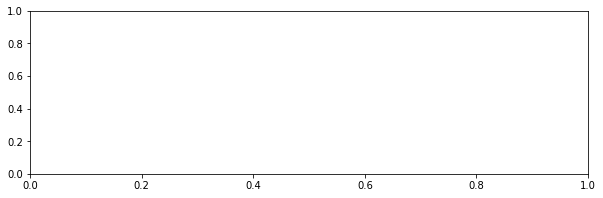

In [44]:
for column in columns[1:]:
    analize_per_category(column)

## 3. Анализ взаимного влияния признаков друг на друга.

In [18]:
data["Medal"] =data["Medal"].fillna(0)
fig = px.scatter_matrix(data, dimensions=["Height", "Weight", "Age", "Year"], color = "Medal")
fig.update_traces(marker=dict(size=2, opacity=0.8))
fig.show()


## 5 "интересных/неожиданных" наблюдений из набора данных.


1) Чем сильнее человек отклоняется по одному из параметров(вес, рост) среди своей группы, тем меньше у него шансов занять призовое место
2)График рост/вес растет, как 1/х, т.е. чем больше рост, тем больше объем тела может быть, чем больше допустимый объем тела, тем соответственно и больше допустимый вес
3)Со временем увеличивается разброс по весу и росту среди участников растет, скорее всего это связанно с добавлением все новых и новых весовых категорий.
4)Пик веса участников приходится на 20-35 лет, с увелечением возраста - вес уменьшается
5)Серебро чаще всего берут люди находящииеся в рамках "средних" показателей своей группы, но золото и бронзу чаще берут люди отклоняющиеся от этих показателей, то есть в условном "центре" находятся серебрянные призеры их окружают золотые и бронзовые медалисты, которых в свою очередь окружают люди не получившии награды в связи с более сильным отклонением своих параметров от "средних"